In [1]:
import json
import os
import requests
import pandas as pd
import numpy as np

In [2]:
with open("./scriptures-json/flat-json/book-of-mormon-flat.json", 'r') as file:
    bom = json.load(file)
with open("./scriptures-json/flat-json/doctrine-and-covenants-flat.json", 'r') as file:
    dc = json.load(file)
with open("./scriptures-json/flat-json/old-testament-flat.json", 'r') as file:
    ot = json.load(file)
with open("./scriptures-json/flat-json/new-testament-flat.json", 'r') as file:
    nt = json.load(file)
with open("./scriptures-json/flat-json/pearl-of-great-price-flat.json", 'r') as file:
    pogp = json.load(file)

In [3]:
bom = bom['verses']
dc = dc['verses']
ot = ot['verses']
nt = nt['verses']
pogp = pogp['verses']

bom = pd.DataFrame(bom)
dc = pd.DataFrame(dc)
ot = pd.DataFrame(ot)
nt = pd.DataFrame(nt)
pogp = pd.DataFrame(pogp)

In [8]:
model_id = "sentence-transformers/all-MiniLM-L6-v2"
hf_token = os.environ.get("HF_TOKEN")
api_url = f"https://api-inference.huggingface.co/pipeline/feature-extraction/{model_id}"
headers = {"Authorization": f"Bearer {hf_token}"}

In [9]:
def query(texts):
    response = requests.post(api_url, headers=headers, json={"inputs": texts, "options":{"wait_for_model":True}})
    return response.json()

In [10]:
bom['embedding'] = query(bom['text'].tolist())
dc['embedding'] = query(dc['text'].tolist())
pogp['embedding'] = query(pogp['text'].tolist())

We have to query the Old and New Testaments by parts

In [11]:
# Split the DataFrame into four equal parts
split_parts = np.array_split(ot['text'], 4)

# Access each split part individually
part1 = split_parts[0]
part2 = split_parts[1]
part3 = split_parts[2]
part4 = split_parts[3]

ot1 = query(part1.tolist())
ot2 = query(part2.tolist())
ot3 = query(part3.tolist())
ot4 = query(part4.tolist())

In [13]:
# Split the DataFrame into four equal parts
split_parts = np.array_split(nt['text'], 4)

# Access each split part individually
nt1 = query(split_parts[0].tolist())
nt2 = query(split_parts[1].tolist())
nt3 = query(split_parts[2].tolist())
nt4 = query(split_parts[3].tolist())

In [14]:
otembedding = ot1 + ot2 + ot3 + ot4
ntembedding = nt1 + nt2 + nt3 + nt4
ot['embedding'] = otembedding
nt['embedding'] = ntembedding

In [15]:
# Put all embeddings into one dataframe
data = pd.concat([ot, nt, bom, dc, pogp], ignore_index=True)

In [16]:
data.to_csv('embeddings.csv', index=False)

In [2]:
# Open csv into df
file_path = 'embeddings.csv'
data = pd.read_csv(file_path)

In [5]:
from ast import literal_eval
data['embedding'] = data['embedding'].apply(lambda x: literal_eval(x))

In [6]:
print(data['embedding'])

0        [0.022822868078947067, 0.0658608078956604, -0....
1        [-0.0044178590178489685, 0.09153897315263748, ...
2        [0.012921378016471863, 0.08982666581869125, 0....
3        [0.02261669933795929, 0.08691146224737167, 0.0...
4        [-0.0015691922744736075, 0.1103328987956047, 0...
                               ...                        
41990    [-0.05361941456794739, -0.0002753171429503709,...
41991    [-0.03884805738925934, 0.051481444388628006, -...
41992    [0.04577989876270294, 0.13778269290924072, -0....
41993    [-0.04523411765694618, 0.032942891120910645, -...
41994    [0.00547053711488843, 0.013346768915653229, -0...
Name: embedding, Length: 41995, dtype: object


In [8]:
import pickle
data.to_pickle('embeddings.pkl')

In [2]:
import pickle
data = pd.read_pickle('embeddings.pkl')

In [12]:
from sklearn.metrics.pairwise import cosine_similarity

embedding_matrix = np.array(data['embedding'].tolist())
similarity_matrix = cosine_similarity(embedding_matrix, embedding_matrix)

: 

: 

In [3]:
# IN BATCHES
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Assume embedding_matrix is a 2D NumPy array containing your data
embedding_matrix = np.array(data['embedding'].tolist())

# Define the batch size (choose an appropriate value based on your memory capacity)
batch_size = 1000

# Calculate the number of batches and the remaining elements
num_batches = len(embedding_matrix) // batch_size
remaining_elements = len(embedding_matrix) % batch_size

# Initialize an empty similarity matrix to store the results
similarity_matrix = np.empty((len(embedding_matrix), len(embedding_matrix)))

# Compute cosine similarity in batches
for i in range(num_batches):
    start_idx = i * batch_size
    end_idx = (i + 1) * batch_size
    similarity_batch = cosine_similarity(embedding_matrix[start_idx:end_idx], embedding_matrix)
    similarity_matrix[start_idx:end_idx, :] = similarity_batch

# Compute the remaining part of the similarity matrix
if remaining_elements > 0:
    start_idx = len(embedding_matrix) - remaining_elements
    similarity_batch = cosine_similarity(embedding_matrix[start_idx:], embedding_matrix)
    similarity_matrix[start_idx:, :] = similarity_batch

# Now similarity_matrix contains the complete cosine similarity matrix


In [4]:
from itertools import combinations

df = data

# Find pairs of similar texts
similar_text_pairs = []
similar_reference_pairs = []
similarity_score_list = []
threshold = 0.75  # Adjust the similarity threshold as desired

# Iterate through all combinations of text pairs
for i, j in combinations(range(len(df)), 2):
    similarity_score = similarity_matrix[i, j]

    if similarity_score > threshold:
        text_pair = (df.loc[i, 'text'], df.loc[j, 'text'])
        reference_pair = (df.loc[i, 'reference'], df.loc[j, 'reference'])
        similar_text_pairs.append(text_pair)
        similar_reference_pairs.append(reference_pair)
        similarity_score_list.append(similarity_score)

In [5]:
print(len(similar_text_pairs))
print(len(similar_reference_pairs))
print(len(similarity_score_list))

27601
27601
27601


In [6]:
print(similar_text_pairs[0], similar_reference_pairs[0], similarity_score_list[0])

('And the earth was without form, and void; and darkness was upon the face of the deep. And the Spirit of God moved upon the face of the waters.', 'And the earth was without form, and void; and I caused darkness to come up upon the face of the deep; and my Spirit moved upon the face of the water; for I am God.') ('Genesis 1:2', 'Moses 2:2') 0.9280895124388329


In [7]:
standard_works = {
    "1 Nephi",
    "2 Nephi",
    "Jacob",
    "Enos",
    "Jarom",
    "Omni",
    "Words of Mormon",
    "Mosiah",
    "Alma",
    "Helaman",
    "3 Nephi",
    "4 Nephi",
    "Mormon",
    "Ether",
    "Moroni",
    "Genesis",
    "Exodus",
    "Leviticus",
    "Numbers",
    "Deuteronomy",
    "Joshua",
    "Judges",
    "Ruth",
    "1 Samuel",
    "2 Samuel",
    "1 Kings",
    "2 Kings",
    "1 Chronicles",
    "2 Chronicles",
    "Ezra",
    "Nehemiah",
    "Esther",
    "Job",
    "Psalms",
    "Proverbs",
    "Ecclesiastes",
    "Song of Solomon",
    "Isaiah",
    "Jeremiah",
    "Lamentations",
    "Ezekiel",
    "Daniel",
    "Hosea",
    "Joel",
    "Amos",
    "Obadiah",
    "Jonah",
    "Micah",
    "Nahum",
    "Habakkuk",
    "Zephaniah",
    "Haggai",
    "Zechariah",
    "Malachi"
    "Matthew",
    "Mark",
    "Luke",
    "John",
    "Acts",
    "Romans",
    "1 Corinthians",
    "2 Corinthians",
    "Galatians",
    "Ephesians",
    "Philippians",
    "Colossians",
    "1 Thessalonians",
    "2 Thessalonians",
    "1 Timothy",
    "2 Timothy",
    "Titus",
    "Philemon",
    "Hebrews",
    "James",
    "1 Peter",
    "2 Peter",
    "1 John",
    "2 John",
    "3 John",
    "Jude",
    "Revelation"
    "Moses",
    "Abraham",
    "Joseph Smith—Matthew",
    "Joseph Smith—History",
    "Articles of Faith"
}


In [8]:
def seperateReference(ref):
    book = ' '.join(ref.split(' ')[:-1])
    chapter = ref.split(' ')[-1].split(':')[0]
    verse = ref.split(' ')[-1].split(':')[1]
    return book, chapter, verse

In [9]:
print(seperateReference(similar_reference_pairs[0][0]))

('Genesis', '1', '2')


In [10]:
embedding_dict = {}
errors = []
for texts, references, score in zip(similar_text_pairs, similar_reference_pairs, similarity_score_list):
    text1, text2 = texts
    ref1, ref2 = references
    book1, chapter1, verse1 = seperateReference(ref1)
    book2, chapter2, verse2 = seperateReference(ref2)
    if book1 not in embedding_dict:
        embedding_dict[book1] = {}
    if book2 not in embedding_dict:
        embedding_dict[book2] = {}
    if ref1 not in embedding_dict[book1]:
        embedding_dict[book1][ref1] = []
    if ref2 not in embedding_dict[book2]:
        embedding_dict[book2][ref2] = []

    embedding_dict[book1][ref1].append((ref2, score))
    embedding_dict[book2][ref2].append((ref1, score))

print(embedding_dict['Genesis']['Genesis 1:2'])

    

[('Moses 2:2', 0.9280895124388329), ('Abraham 4:2', 0.870262367812787)]


In [131]:
with open("embedding_dict.json", "w") as json_file:
    json.dump(embedding_dict, json_file)

In [11]:
references_list = data['reference']

# Extract the book from each reference
books_list = [' '.join(reference.split(' ')[:-1]) for reference in references_list]
data['book'] = books_list
print(data['book'])

0                  Genesis
1                  Genesis
2                  Genesis
3                  Genesis
4                  Genesis
               ...        
41990    Articles of Faith
41991    Articles of Faith
41992    Articles of Faith
41993    Articles of Faith
41994    Articles of Faith
Name: book, Length: 41995, dtype: object


In [ ]:
#We need to filter for a subset

# Plotting and Examining Embeddings in just the Book of Mormon

In [17]:
# Assuming your DataFrame is named 'df' and the reference column is named 'reference'
# List of book names from the Book of Mormon
book_of_mormon_books = ['1 Nephi', '2 Nephi', 'Jacob', 'Enos', 'Jarom', 'Omni', 'Words of Mormon',
                        'Mosiah', 'Alma', 'Helaman', '3 Nephi', '4 Nephi', 'Mormon', 'Ether', 'Moroni']

# Filter the DataFrame to include rows where the reference column contains any of the book names
df = data[data['reference'].str.contains('|'.join(book_of_mormon_books))]

# Now 'filtered_df' contains only the rows where the reference column contains the name of a Book of Mormon book


In [19]:
print(df['book'])

31102    1 Nephi
31103    1 Nephi
31104    1 Nephi
31105    1 Nephi
31106    1 Nephi
          ...   
37701     Moroni
37702     Moroni
37703     Moroni
37704     Moroni
37705     Moroni
Name: book, Length: 6604, dtype: category
Categories (87, object): ['1 Chronicles', '1 Corinthians', '1 John', '1 Kings', ..., 'Titus', 'Words of Mormon', 'Zechariah', 'Zephaniah']


In [27]:
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

In [28]:
# Convert 'book' column to 'category' dtype
df['book'] = df['book'].astype('category')

# Create a dictionary to map category codes to labels
book_labels = dict(enumerate(df['book'].cat.categories))

# Get the embeddings as a matrix
embedding_matrix = np.array(df['embedding'].tolist())

# Perform clustering with K-means
num_clusters = 6  # Specify the number of clusters
kmeans = KMeans(n_clusters=num_clusters)
cluster_labels = kmeans.fit_predict(embedding_matrix)

# Perform dimensionality reduction with t-SNE
tsne = TSNE(n_components=2, random_state=42)
embedding_2d = tsne.fit_transform(embedding_matrix)

# Add the cluster labels and 'book' column to the DataFrame
df['cluster_label'] = cluster_labels




C:\Users\justi\AppData\Local\Temp\ipykernel_42220\889186921.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['book'] = df['book'].astype('category')
c:\Data\Personal\coding\scriptural-embeddings\.conda\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\justi\AppData\Local\Temp\ipykernel_42220\889186921.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable

c:\Data\Personal\coding\scriptural-embeddings\.conda\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Data\Personal\coding\scriptural-embeddings\.conda\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Data\Personal\coding\scriptural-embeddings\.conda\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Data\Personal\coding\scriptural-embeddings\.conda\lib\site-packages\sklearn\cluster\_kme

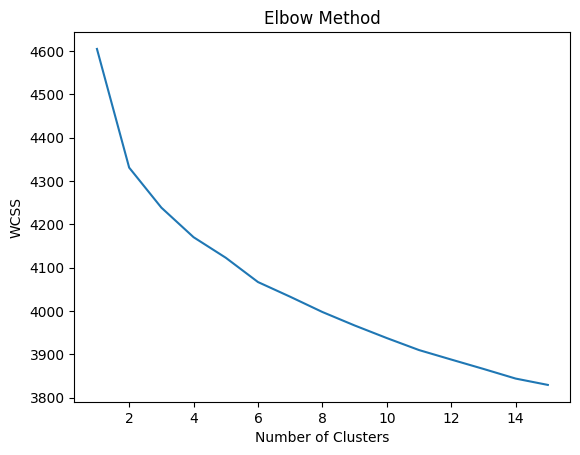

In [25]:
# Perform clustering with K-means
max_clusters = 15  # Maximum number of clusters to test
wcss = []  # List to store the within-cluster sum of squares

for num_clusters in range(1, max_clusters + 1):
    kmeans = KMeans(n_clusters=num_clusters)
    kmeans.fit(embedding_matrix)
    wcss.append(kmeans.inertia_)

# Plot the WCSS against the number of clusters
plt.plot(range(1, max_clusters + 1), wcss)
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.title('Elbow Method')
plt.show()


In [26]:
# Create a dictionary to map category codes to labels
book_labels = dict(enumerate(df['book'].cat.categories))

# Set the desired figure size
fig, ax = plt.subplots(figsize=(20, 16), dpi=1000)  # Adjust the figsize parameter as needed
# Plot the clusters colored by the cluster labels
scatter = ax.scatter(embedding_2d[:, 0], embedding_2d[:, 1], c=df['cluster_label'], cmap='Set1', s=10)  # Switch to 'cluster_label' for coloring

# Create a legend using the cluster labels
handles, _ = scatter.legend_elements()
labels = [str(label) for label in df['cluster_label'].unique()]  # Get unique cluster labels
legend = ax.legend(handles, labels, title='Cluster')
ax.add_artist(legend)

# Add reference labels to each point
for i, reference in enumerate(df['reference']):
    ax.text(embedding_2d[i, 0], embedding_2d[i, 1], reference, fontsize=1, ha='center', va='center')

plt.show()


In [121]:
# Group the DataFrame by 'book' and 'cluster_label' and calculate the count
grouped = df.groupby(['book', 'cluster_label']).size().reset_index(name='count')

# Calculate the total count of each book
book_counts = grouped.groupby('book')['count'].sum()

# Calculate the percentage of each book in each cluster
grouped['percentage'] = grouped['count'] / grouped['book'].map(book_counts) * 100

# Print the statistics
print(grouped[0:20])

       book  cluster_label  count  percentage
0   1 Nephi              0     18    2.912621
1   1 Nephi              1    150   24.271845
2   1 Nephi              2     81   13.106796
3   1 Nephi              3    169   27.346278
4   1 Nephi              4    131   21.197411
5   1 Nephi              5     69   11.165049
6   2 Nephi              0      2    0.256739
7   2 Nephi              1     51    6.546855
8   2 Nephi              2     48    6.161746
9   2 Nephi              3    227   29.139923
10  2 Nephi              4    422   54.172015
11  2 Nephi              5     29    3.722721
12  3 Nephi              0     11    1.401274
13  3 Nephi              1    185   23.566879
14  3 Nephi              2     93   11.847134
15  3 Nephi              3    256   32.611465
16  3 Nephi              4    182   23.184713
17  3 Nephi              5     58    7.388535
18  4 Nephi              0      3    6.122449
19  4 Nephi              1     20   40.816327


In [1]:
# Define the order of books
book_order = ['1 Nephi', '2 Nephi', 'Jacob', 'Enos', 'Jarom', 'Omni', 'Words of Mormon', 'Mosiah',
              'Alma', 'Helaman', '3 Nephi', '4 Nephi', 'Mormon', 'Ether', 'Moroni']

# Convert 'book' column to categorical with the specified order
df['book'] = pd.Categorical(df['book'], categories=book_order, ordered=True)

# Filter the DataFrame for cluster_label == 1
cluster_1_df = df[df['cluster_label'] == 4]
#cluster_1_df = df

# Group the filtered DataFrame by 'book' and calculate the count
grouped = cluster_1_df.groupby('book').size().reset_index(name='count')

# Calculate the total count of cluster_label == 1 for each book
total_count = grouped['count'].sum()

# Calculate the percentage of each book in cluster_label == 1
grouped['percentage'] = grouped['count'] / total_count * 100

# Print the statistics
print(grouped)


NameError: name 'pd' is not defined

In [141]:
# Assuming you have a DataFrame called 'df' with columns 'reference', 'text', 'embedding', and 'book' for each verse

# Define the order of books
book_order = ['1 Nephi', '2 Nephi', 'Jacob', 'Enos', 'Jarom', 'Omni', 'Words of Mormon', 'Mosiah',
              'Alma', 'Helaman', '3 Nephi', '4 Nephi', 'Mormon', 'Ether', 'Moroni']

# Convert 'book' column to categorical with the specified order
df['book'] = pd.Categorical(df['book'], categories=book_order, ordered=True)

# Calculate the total number of verses for each book
book_verse_counts = df.groupby('book')['reference'].count()

# Filter the DataFrame for cluster_label == 1
cluster_1_df = df[df['cluster_label'] == 4]

# Group the filtered DataFrame by 'book' and calculate the total number of verses and the count
grouped = cluster_1_df.groupby('book').agg({'reference': 'count', 'text': 'sum'}).reset_index()
grouped.rename(columns={'reference': 'count', 'text': 'total_text'}, inplace=True)

# Calculate the percentage of each book in cluster_label == 1 based on the total number of verses
grouped['percentage'] = grouped['count'] / grouped['book'].map(book_verse_counts) * 100

# Print the statistics
print(grouped[['book', 'count', 'percentage']])


               book  count  percentage
0           1 Nephi    131   21.197411
1           2 Nephi    422   54.172015
2             Jacob     86   42.364532
3              Enos      1    3.703704
4             Jarom      2   13.333333
5              Omni      2    6.666667
6   Words of Mormon      0    0.000000
7            Mosiah    129   16.433121
8              Alma    281   14.227848
9           Helaman     90   18.108652
10          3 Nephi    182   23.184713
11          4 Nephi      0    0.000000
12           Mormon     43   18.942731
13            Ether     47   10.854503
14           Moroni     30   18.404908
